In [1]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import re
import json
from itertools import groupby

In [9]:
line = '2023-07-26 17:26:45,895 INFO xbee_backend (97): Sent unicast :{"CMD": "HMOD", "DID": "A418980178", "TS": "1690392405", "MODE": "WIND"} originated from wind-sensor'
l = line.split("}")
l[1].strip()

'originated from wind-sensor'

In [3]:
LOG_DIRs = ["./logs_dir//array2_3723/", "./logs_dir/array3_5723/"]
array2_logs = os.listdir(LOG_DIRs[0])
array3_logs = os.listdir(LOG_DIRs[1])

In [4]:
hst2 = []
dst2 = []
dstu = []

In [5]:
for _ in array2_logs:
    print(_)
    with open(f"{LOG_DIRs[1]}{_}", 'r') as data:
        for line in data.readlines():
            if "HST2" in line:
                hst2.append(line)
            elif "DST2" in line:
                dst2.append(line)
            elif "DSTU" in line:
                dstu.append(line)
            else:
                continue

xbee_backend.log
xbee_backend.log.1
xbee_backend.log.2
xbee_backend.log.3
xbee_backend.log.4


In [6]:
hst2_json = []

In [7]:
for _ in hst2:
    req_json = re.search("{.+?}",_)
    print(req_json.group())
    hst2_json.append(json.loads(req_json.group()))

{"CMD": "HST2", "CID": 0, "DID": "A011403011", "TS": "1688540900"}
{"CMD": "HST2", "CID": 0, "DID": "A011403014", "TS": "1688540901"}
{"CMD": "HST2", "CID": 0, "DID": "A011403015", "TS": "1688540902"}
{"CMD": "HST2", "CID": 0, "DID": "A011403016", "TS": "1688540903"}
{"CMD": "HST2", "CID": 0, "DID": "A011403017", "TS": "1688540907"}
{"CMD": "HST2", "CID": 0, "DID": "A011403018", "TS": "1688540908"}
{"CMD": "HST2", "CID": 0, "DID": "A011403019", "TS": "1688540908"}
{"CMD": "HST2", "CID": 0, "DID": "A011403021", "TS": "1688540910"}
{"CMD": "HST2", "CID": 0, "DID": "A011403022", "TS": "1688540911"}
{"CMD": "HST2", "CID": 0, "DID": "A011403023", "TS": "1688540914"}
{"CMD": "HST2", "CID": 0, "DID": "A011403024", "TS": "1688540915"}
{"CMD": "HST2", "CID": 0, "DID": "A011403026", "TS": "1688540918"}
{"CMD": "HST2", "CID": 0, "DID": "A011403027", "TS": "1688540922"}
{"CMD": "HST2", "CID": 0, "DID": "A011403028", "TS": "1688540925"}
{"CMD": "HST2", "CID": 0, "DID": "A011403030", "TS": "16885409

In [8]:
dst2_json = []
for _ in dst2:
    req_json = re.search("{.+?}",_)
    print(req_json.group())
    try:
        dst2_json.append(json.loads(req_json.group()))
    except:
        dst2_json.append(json.loads(str({})))


{"TS":"1688540787","DID":"A011403011","CMD":"DST2","CID":0,"VALUES":"[EMERGENCY-STOW,0.86,MOTOR-OFF,0,0.04,0.60,-0.05,26.66,0.01,15.56,14.75,COMPLETED,[[194254,-5.00],[042541,-1.48]]]"}
{"TS":"1688540782","DID":"A011403014","CMD":"DST2","CID":0,"VALUES":"[EMERGENCY-STOW,0.27,MOTOR-OFF,0,0.04,0.60,-0.04,26.66,0.00,15.50,15.18,COMPLETED,[[194254,-5.00],[042541,-1.48]]]"}
{"TS":"1688540782","DID":"A011403015","CMD":"DST2","CID":0,"VALUES":"[EMERGENCY-STOW,0.44,MOTOR-OFF,0,0.05,0.60,-0.03,26.69,0.03,14.75,14.68,COMPLETED,[[194254,-5.00],[042541,-1.48]]]"}
{"TS":"1688540783","DID":"A011403017","CMD":"DST2","CID":0,"VALUES":"[EMERGENCY-STOW,0.50,MOTOR-OFF,0,0.05,0.60,-0.05,26.60,0.02,14.81,14.62,COMPLETED,[[194254,-5.00],[042541,-1.48]]]"}
{"TS":"1688540783","DID":"A011403018","CMD":"DST2","CID":0,"VALUES":"[EMERGENCY-STOW,0.24,MOTOR-OFF,0,0.04,0.60,-0.03,26.66,0.00,14.68,14.12,COMPLETED,[[194254,-5.00],[042541,-1.48]]]"}
{"TS":"1688540784","DID":"A011403019","CMD":"DST2","CID":0,"VALUES":"[

In [9]:
dstu_json =[]
for _ in dstu:
    req_json = re.search("{.+?}",_)
    print(req_json.group())
    try:
        dstu_json.append(json.loads(req_json.group()))
    except:
        continue

{"TS":"1688546414","DID":"A011403076","CMD":"DSTU","MODE":"EMERGENCY-STOW","PANGLE":"0.0","CANGLE":"-0.0","BTEMP":"13.37","BATV":"26.59","STATUS":"0"}
{"TS":"1688551860","DID":"A011403052","CMD":"DSTU","MODE":"EMERGENCY-STOW","PANGLE":"0.0","CANGLE":"0.1","BTEMP":"11.62","BATV":"26.57","STATUS":"0"}
{"TS":"1688500567","DID":"A011403018","CMD":"DSTU","MODE":"EMERGENCY-STOW","PANGLE":"0.0","CANGLE":"-0.0","BTEMP":"30.37","BATV":"27.49","STATUS":"0"}
{"TS":"1688500572","DID":"A011403018","CMD":"DSTU","MODE":"EMERGENCY-STOW","PANGLE":"-0.0","CANGLE":"-0.0","BTEMP":"30.37","BATV":"27.49","STATUS":"0"}
{"TS":"1688502699","DID":"A011403077","CMD":"DSTU","MODE":"COMMERROR-STOW","PANGLE":"-0.2","CANGLE":"0.1","BTEMP":"32.00","BATV":"27.67","STATUS":"100"}
{"TS":"1688503448","DID":"A011403077","CMD":"DSTU","MODE":"EMERGENCY-STOW","PANGLE":"0.2","CANGLE":"-0.0","BTEMP":"31.81","BATV":"27.66","STATUS":"0"}
{"TS":"1688505768","DID":"A011403023","CMD":"DSTU","MODE":"EMERGENCY-STOW","PANGLE":"0.0","C

In [10]:
hst2_json[0]

{'CMD': 'HST2', 'CID': 0, 'DID': 'A011403011', 'TS': '1688540900'}

In [11]:
dst2_json[0]

{'TS': '1688540787',
 'DID': 'A011403011',
 'CMD': 'DST2',
 'CID': 0,
 'VALUES': '[EMERGENCY-STOW,0.86,MOTOR-OFF,0,0.04,0.60,-0.05,26.66,0.01,15.56,14.75,COMPLETED,[[194254,-5.00],[042541,-1.48]]]'}

In [12]:
dstu_json[0]

{'TS': '1688546414',
 'DID': 'A011403076',
 'CMD': 'DSTU',
 'MODE': 'EMERGENCY-STOW',
 'PANGLE': '0.0',
 'CANGLE': '-0.0',
 'BTEMP': '13.37',
 'BATV': '26.59',
 'STATUS': '0'}

In [13]:
df_hst2 = pd.DataFrame(hst2_json)

In [14]:
df_hst2 = df_hst2.drop("CID", axis= 1)

In [15]:
df_dst2 = pd.DataFrame(dst2_json)
df_dst2 = df_dst2.drop(columns= ["CID", "VALUES"])

In [16]:
df_dstu = pd.DataFrame(dstu_json)

In [17]:
print(df_hst2.head())
print(df_dst2.head())
print(df_dstu.head())

    CMD         DID          TS
0  HST2  A011403011  1688540900
1  HST2  A011403014  1688540901
2  HST2  A011403015  1688540902
3  HST2  A011403016  1688540903
4  HST2  A011403017  1688540907
           TS         DID   CMD
0  1688540787  A011403011  DST2
1  1688540782  A011403014  DST2
2  1688540782  A011403015  DST2
3  1688540783  A011403017  DST2
4  1688540783  A011403018  DST2
           TS         DID   CMD            MODE PANGLE CANGLE  BTEMP   BATV  \
0  1688546414  A011403076  DSTU  EMERGENCY-STOW    0.0   -0.0  13.37  26.59   
1  1688551860  A011403052  DSTU  EMERGENCY-STOW    0.0    0.1  11.62  26.57   
2  1688500567  A011403018  DSTU  EMERGENCY-STOW    0.0   -0.0  30.37  27.49   
3  1688500572  A011403018  DSTU  EMERGENCY-STOW   -0.0   -0.0  30.37  27.49   
4  1688502699  A011403077  DSTU  COMMERROR-STOW   -0.2    0.1  32.00  27.67   

  STATUS  
0      0  
1      0  
2      0  
3      0  
4    100  


In [18]:
hst2_sam = df_hst2
dst2_sam = df_dst2

In [19]:
hst2_sam["TS"] = pd.to_datetime(hst2_sam["TS"], unit='s')
hst2_sam

/tmp/ipykernel_71030/1894753801.py:1: FutureWarning: The behavior of 'to_datetime' with 'unit' when parsing strings is deprecated. In a future version, strings will be parsed as datetime strings, matching the behavior without a 'unit'. To retain the old behavior, explicitly cast ints or floats to numeric type before calling to_datetime.
  hst2_sam["TS"] = pd.to_datetime(hst2_sam["TS"], unit='s')


,CMD,DID,TS
0,HST2,A011403011,2023-07-05 07:08:48
1,HST2,A011403014,2023-07-05 07:08:48
2,HST2,A011403015,2023-07-05 07:08:48
3,HST2,A011403016,2023-07-05 07:08:48
4,HST2,A011403017,2023-07-05 07:08:48
...,...,...,...
49798,HST2,A011402074,2023-07-01 14:06:56
49799,HST2,A011402075,2023-07-01 14:06:56
49800,HST2,A011402076,2023-07-01 14:06:56
49801,HST2,A011402079,2023-07-01 14:06:56


In [20]:
dst2_sam["TS"] = pd.to_datetime(dst2_sam["TS"], unit='s')
dst2_sam

/tmp/ipykernel_71030/558747222.py:1: FutureWarning: The behavior of 'to_datetime' with 'unit' when parsing strings is deprecated. In a future version, strings will be parsed as datetime strings, matching the behavior without a 'unit'. To retain the old behavior, explicitly cast ints or floats to numeric type before calling to_datetime.
  dst2_sam["TS"] = pd.to_datetime(dst2_sam["TS"], unit='s')


,TS,DID,CMD
0,2023-07-05 07:06:40,A011403011,DST2
1,2023-07-05 07:06:40,A011403014,DST2
2,2023-07-05 07:06:40,A011403015,DST2
3,2023-07-05 07:06:40,A011403017,DST2
4,2023-07-05 07:06:40,A011403018,DST2
...,...,...,...
30938,2023-07-01 14:06:56,A011402073,DST2
30939,2023-07-01 14:04:48,A011402075,DST2
30940,2023-07-01 14:04:48,A011402076,DST2
30941,2023-07-01 14:04:48,A011402079,DST2


In [31]:
count_df = pd.DataFrame()
count_df_list = []
for i,_ in enumerate(hst2_sam["TS"]):
    sam_dic = {}
    print(hst2_sam["TS"][i])
    sam_dic["TS"] = hst2_sam["TS"][i]
    sam1_filter = hst2_sam[hst2_sam['TS'] == hst2_sam["TS"][i]]
    print(sam1_filter.head())
    # sam_dic["HST2_DID"] = sam1_filter['DID']
    print(len(sam1_filter))
    sam_dic["HST2 Count"] = len(sam1_filter)
    print(sam1_filter.shape[0])
    sam2_filter = dst2_sam[dst2_sam['TS'] == hst2_sam["TS"][i]]
    print(sam2_filter.head())
    # sam_dic['DST2_DID'] = sam2_filter.loc[sam2_filter['DID'] != "", 'DID']
    # print(sam_dic['DST2_DID'])
    print(len(sam2_filter))
    sam_dic["DST2 Count"] = len(sam2_filter)
    count_df_list.append(sam_dic)
count_df = pd.DataFrame(count_df_list)

2023-07-05 07:08:48
    CMD         DID                  TS
0  HST2  A011403011 2023-07-05 07:08:48
1  HST2  A011403014 2023-07-05 07:08:48
2  HST2  A011403015 2023-07-05 07:08:48
3  HST2  A011403016 2023-07-05 07:08:48
4  HST2  A011403017 2023-07-05 07:08:48
44
44
                    TS         DID   CMD
12 2023-07-05 07:08:48  A011403043  DST2
13 2023-07-05 07:08:48  A011403048  DST2
14 2023-07-05 07:08:48  A011403057  DST2
15 2023-07-05 07:08:48  A011403059  DST2
16 2023-07-05 07:08:48  A011403060  DST2
20
2023-07-05 07:08:48
    CMD         DID                  TS
0  HST2  A011403011 2023-07-05 07:08:48
1  HST2  A011403014 2023-07-05 07:08:48
2  HST2  A011403015 2023-07-05 07:08:48
3  HST2  A011403016 2023-07-05 07:08:48
4  HST2  A011403017 2023-07-05 07:08:48
44
44
                    TS         DID   CMD
12 2023-07-05 07:08:48  A011403043  DST2
13 2023-07-05 07:08:48  A011403048  DST2
14 2023-07-05 07:08:48  A011403057  DST2
15 2023-07-05 07:08:48  A011403059  DST2
16 2023-07-05 

In [22]:
count_df = count_df.drop_duplicates(subset="TS")

In [23]:
count_df.head(30)

,TS,HST2 Count,DST2 Count
0,2023-07-05 07:08:48,44,20
44,2023-07-05 07:10:56,13,0
57,2023-07-05 07:13:04,17,32
74,2023-07-05 07:15:12,40,6
114,2023-07-05 07:19:28,57,20
171,2023-07-05 07:23:44,37,20
208,2023-07-05 07:25:52,20,15
228,2023-07-05 07:28:00,15,5
243,2023-07-05 07:30:08,42,14
285,2023-07-05 07:34:24,18,4


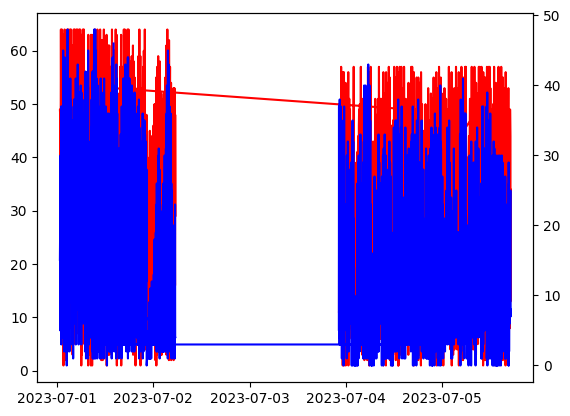

In [24]:
fig, ax1 = plt.subplots()
ax1.plot(count_df['TS'], count_df['HST2 Count'], color='red')

ax2 = ax1.twinx()

ax2.plot(count_df['TS'], count_df['DST2 Count'], color='blue')

plt.show()


In [25]:
hst2_sam

,CMD,DID,TS
0,HST2,A011403011,2023-07-05 07:08:48
1,HST2,A011403014,2023-07-05 07:08:48
2,HST2,A011403015,2023-07-05 07:08:48
3,HST2,A011403016,2023-07-05 07:08:48
4,HST2,A011403017,2023-07-05 07:08:48
...,...,...,...
49798,HST2,A011402074,2023-07-01 14:06:56
49799,HST2,A011402075,2023-07-01 14:06:56
49800,HST2,A011402076,2023-07-01 14:06:56
49801,HST2,A011402079,2023-07-01 14:06:56


In [26]:
dst2_sam

,TS,DID,CMD
0,2023-07-05 07:06:40,A011403011,DST2
1,2023-07-05 07:06:40,A011403014,DST2
2,2023-07-05 07:06:40,A011403015,DST2
3,2023-07-05 07:06:40,A011403017,DST2
4,2023-07-05 07:06:40,A011403018,DST2
...,...,...,...
30938,2023-07-01 14:06:56,A011402073,DST2
30939,2023-07-01 14:04:48,A011402075,DST2
30940,2023-07-01 14:04:48,A011402076,DST2
30941,2023-07-01 14:04:48,A011402079,DST2


In [27]:
count_df

,TS,HST2 Count,DST2 Count
0,2023-07-05 07:08:48,44,20
44,2023-07-05 07:10:56,13,0
57,2023-07-05 07:13:04,17,32
74,2023-07-05 07:15:12,40,6
114,2023-07-05 07:19:28,57,20
...,...,...,...
49638,2023-07-01 13:56:16,58,34
49696,2023-07-01 13:58:24,6,17
49702,2023-07-01 14:00:32,38,33
49740,2023-07-01 14:02:40,26,3


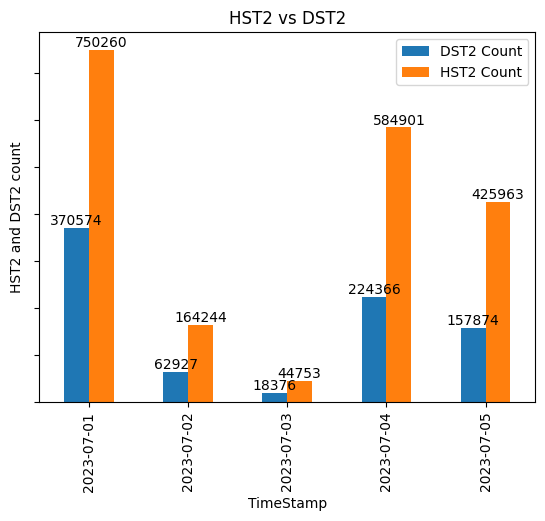

In [40]:
# count_df['TS'] = count_df['TS'].dt.date
pivot_table = count_df.pivot_table(values=['DST2 Count', "HST2 Count"], index="TS", aggfunc=sum)
ax = pivot_table.plot(kind='bar')
ax.set_yticklabels([])
plt.xlabel("TimeStamp")
plt.ylabel("HST2 and DST2 count")
plt.title("HST2 vs DST2")
for cont in ax.containers:
    ax.bar_label(cont, fmt='%.0f', label_type='edge')
plt.show()